---

# Análise de dados Airbnb

## Desafio Airbnb San Francisco 

### Viviane Renizia Mendes Silva
---

## Airbnb
O [Airbnb](https://www.airbnb.com) transformou radicalmente o setor de hospedagem, estabelecendo uma ponte entre pessoas que querem alugar suas propriedades e viajantes em busca de estadias únicas e sob medida. A plataforma oferece milhões de opções de acomodação ao redor do mundo, fomentando uma comunidade global de anfitriões e hóspedes.

Desde a sua fundação em 2008, o Airbnb já acumulou mais de **4 milhões de anfitriões**, que receberam **1,4 bilhão de hóspedes** em praticamente todos os países.

| Uma das inovações do Airbnb é a disponibilização de dados do seu site para algumas das cidades e locais mais importantes do mundo. Através do portal [Inside Airbnb](http://insideairbnb.com/get-the-data.html), é possível fazer o download de uma vasta quantidade de dados, que podem ser utilizados para desenvolver projetos e análises em *Data Science*. | ![Analisando Airbnb](https://starpng.com/public/uploads/preview/airbnb-logo-png-image-transparent-11576529610h66k5pzqsg.png) |
| ----------------- | ------------------------------------------------------------ |
| (Para mais informações, acesse: [Sobre o Airbnb](https://news.airbnb.com/about-us/)) |                                                              |




---


## San Francisco, California - Estados Unidos

Fundada em 1776 por colonialistas espanhóis, a cidade iniciou com a construção do Presídio, perto da região da Golden Gate, e da Missão de São Francisco de Assis. Posteriormente, em 1849, após tornar-se território dos Estados Unidos, a cidade vivenciou o boom da corrida do ouro, tornando-se a mais significativa da costa oeste americana. Entretanto, em 1906, um devastador terremoto seguido por um grande incêndio destruiu cerca de 80% da cidade, marcando um dos momentos mais trágicos de sua história.

<center><img alt="Localização Havaí" width="70%" src="https://img.freepik.com/fotos-premium/sao-francisco-e-california-no-mapa-dos-eua-viagem-nos-eua_90380-2140.jpg?w=2000
"></center>

Atualmente, San Francisco oferece atividades o ano todo, independentemente do clima, seja chuva ou sol, frio ou mais frio - uma brincadeira comum devido ao seu clima notoriamente fresco, mesmo no verão. O clima varia entre os bairros: pode estar ensolarado no Golden Gate Park, mas nublado e ventoso no Embarcadero. Mesmo com tempo ruim em San Francisco, o sol pode estar brilhando em Sausalito.


<center><img alt="Cultura Havaíana" width="70%" src="https://f3m4u8n4.rocketcdn.me/wp-content/uploads/2018/03/roteiro-san-francisco-o-que-fazer-mapa-turismo.jpg"></center>

### **Pontos turísticos:**


> ### Ponte Golden Gate

> ### Lombard Street

> ###  Fisherman’s Wharf e Pier 39

> ### Aquarium of the Bay

> ### Ilha de Alcatraz

> ### Alamo Square e Painted Ladies

---
## Base de dados fornecida e objetivos
A base de dados airbnb.csv (dados abertos da plataforma airbnb) contém dados de casas e apartamentos que estão disponíveis para aluguel e as características que influenciam na composição do preço da locação. De posse dos dados, faça o processo de preparação, análise exploratória e modelagem com o objetivo de entender as características dos imóveis e auxiliar no agrupamento e/ou precificação dos imóveis de aluguel.

**O objetivo do problema proposto é ajudar as áreas de negócios do Airbnb a maximizar a rentabilidade e/ou a taxa de ocupação das casas e apartamentos disponíveis para aluguel.**

**OBS: Será avaliada a qualidade do código e a solução proposta para o problema. Uma sugestão de metodologias para produtização do modelo criado será um diferencial (Não precisa ser implementada).**

---

In [1]:
# Instalando o Pydeck
!pip install pydeck -q

In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.linear_model import LinearRegression
import numpy as np
from sklearn.preprocessing import OneHotEncoder
import folium
from folium.plugins import HeatMap
import geopandas as gpd
import pydeck as pdk
import matplotlib.colors as mcolors
import datetime
import branca.colormap as cm
import geopandas as gpd
import seaborn as sns
import matplotlib as mpl

%matplotlib inline

In [3]:
df_airbnb = pd.read_excel("input/airbnb_data.xlsx")

---
## Análise dos Dados


Antes de iniciar qualquer análise, é necessário verificar a estrutura do  *dataset*. Desse modo, serão analisadas as 5 primeiras entradas:

In [4]:
df_airbnb.head(5)

,host_is_superhost,cancellation_policy,instant_bookable,host_total_listings_count,neighbourhood_cleansed,latitude,longitude,property_type,room_type,accommodates,...,bedrooms_na,bathrooms_na,beds_na,review_scores_rating_na,review_scores_accuracy_na,review_scores_cleanliness_na,review_scores_checkin_na,review_scores_communication_na,review_scores_location_na,review_scores_value_na
0,t,moderate,t,1.0,Western Addition,3776931.0,-12243386.0,Apartment,Entire home/apt,3.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,f,strict_14_with_grace_period,f,2.0,Bernal Heights,3774511.0,-12242102.0,Apartment,Entire home/apt,5.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,f,strict_14_with_grace_period,f,10.0,Haight Ashbury,3776669.0,-1224525.0,Apartment,Private room,2.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,f,strict_14_with_grace_period,f,10.0,Haight Ashbury,3776487.0,-12245183.0,Apartment,Private room,2.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,f,strict_14_with_grace_period,f,2.0,Western Addition,3777525.0,-12243637.0,House,Entire home/apt,5.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


Após verificar a estrutura do *dataset*, e seguir o dicionário fornecido, abaixo segue o dicionário das características que cada variável (coluna) representa.

Dicionário de dados:

> **host_is_superhost:** Indica se o anfitrião é um "superhost" no Airbnb, um título dado a anfitriões que oferecem experiências excepcionais aos hóspedes.

> **cancellation_policy:** Refere-se à política de cancelamento da propriedade. Pode variar de flexível a rigorosa.

> **instant_bookable:** Mostra se a propriedade pode ser reservada instantaneamente sem a necessidade de aprovação prévia do anfitrião.

> **host_total_listings_count:** O número total de listagens que o anfitrião possui no Airbnb.

> **neighbourhood_cleansed:** Uma avaliação da limpeza do bairro onde a propriedade está localizada.

> **latitude:** A latitude geográfica da propriedade.

> **longitude:** A longitude geográfica da propriedade.

> **property_type:** O tipo de propriedade, como apartamento, casa, estúdio, etc.

> **room_type:** Tipo de quarto oferecido, como quarto inteiro, quarto compartilhado ou casa/apartamento inteiro.

> **accommodates:** O número máximo de pessoas que a propriedade pode acomodar.

> **bathrooms:** O número de banheiros disponíveis na propriedade.

> **bedrooms:** O número de quartos na propriedade.

> **beds:** O número total de camas disponíveis na propriedade.

> **bed_type:** O tipo de cama disponível, como cama de casal, solteiro, sofá-cama, etc.

> **minimum_nights:** O número mínimo de noites requerido para reservar a propriedade.

> **number_of_reviews:** O número total de avaliações que a propriedade recebeu.

> **review_scores_rating:** A pontuação geral de avaliação da propriedade, geralmente de 1 a 100.

> **review_scores_accuracy:** Pontuação relativa à precisão da descrição da propriedade nos anúncios.

> **review_scores_cleanliness:** Pontuação relativa à limpeza da propriedade.

> **review_scores_checkin:** Pontuação relativa à experiência de check-in.

> **review_scores_communication:** Pontuação relativa à comunicação com o anfitrião.

> **review_scores_location:** Pontuação relativa à localização da propriedade.

> **review_scores_value:** Pontuação relativa ao valor geral da estadia.

> **price:** O preço da estadia por noite.

> **review_scores_rating_na:** Número de avaliações relacionadas à pontuação de avaliação geral.

> **review_scores_accuracy_na:** Número de avaliações relacionadas à pontuação de precisão da descrição da propriedade.

> **review_scores_cleanliness_na:** Número de avaliações relacionadas à pontuação de limpeza da propriedade.

> **review_scores_checkin_na:** Número de avaliações relacionadas à pontuação do processo de check-in.

> **review_scores_communication_na:** Número de avaliações relacionadas à pontuação de comunicação com o anfitrião.

> **review_scores_location_na:** Número de avaliações relacionadas à pontuação da localização da propriedade.

> **review_scores_value_na:** Número de avaliações relacionadas à pontuação do valor geral da estadia.

> **bedrooms_na:** Número de quartos.

> **bathrooms_na:** Número de banheiros.

> **beds_na:** Número de camas.

### **Quantidade de atributos (variáveis) e de entradas do conjunto de dados**

In [5]:
print(f'Entradas no DataFrame: {df_airbnb.shape[0]} linhas no total')
print(f'Variáveis no DataFrame: {df_airbnb.shape[1]} colunas no total')

Entradas no DataFrame: 7146 linhas no total
Variáveis no DataFrame: 34 colunas no total


In [6]:
display(df_airbnb.dtypes)

host_is_superhost                  object
cancellation_policy                object
instant_bookable                   object
host_total_listings_count         float64
neighbourhood_cleansed             object
latitude                          float64
longitude                         float64
property_type                      object
room_type                          object
accommodates                      float64
bathrooms                          object
bedrooms                          float64
beds                              float64
bed_type                           object
minimum_nights                    float64
number_of_reviews                 float64
review_scores_rating              float64
review_scores_accuracy            float64
review_scores_cleanliness         float64
review_scores_checkin             float64
review_scores_communication       float64
review_scores_location            float64
review_scores_value               float64
price                             

### **Porcentagem de valores ausentes no *dataset***

Pode-se notar que, surpreendentemente, nenhuma variável no *dataset* apresenta valores ausentes:

In [7]:
missing_values = df_airbnb.isnull().sum()

missing_values = missing_values[missing_values > 0]

missing_values_percentage = (missing_values / len(df_airbnb)) * 100

missing_df = pd.DataFrame({'Variáveis faltantes': missing_values, 'Porcentagem': missing_values_percentage})
missing_df.sort_values(by='Porcentagem', ascending=False)

,Variáveis faltantes,Porcentagem


### **Tipo de distribuição das variáveis** 

Será utilizado o **histograma** para identificar a distribuição das variáveis do *dataset*. 

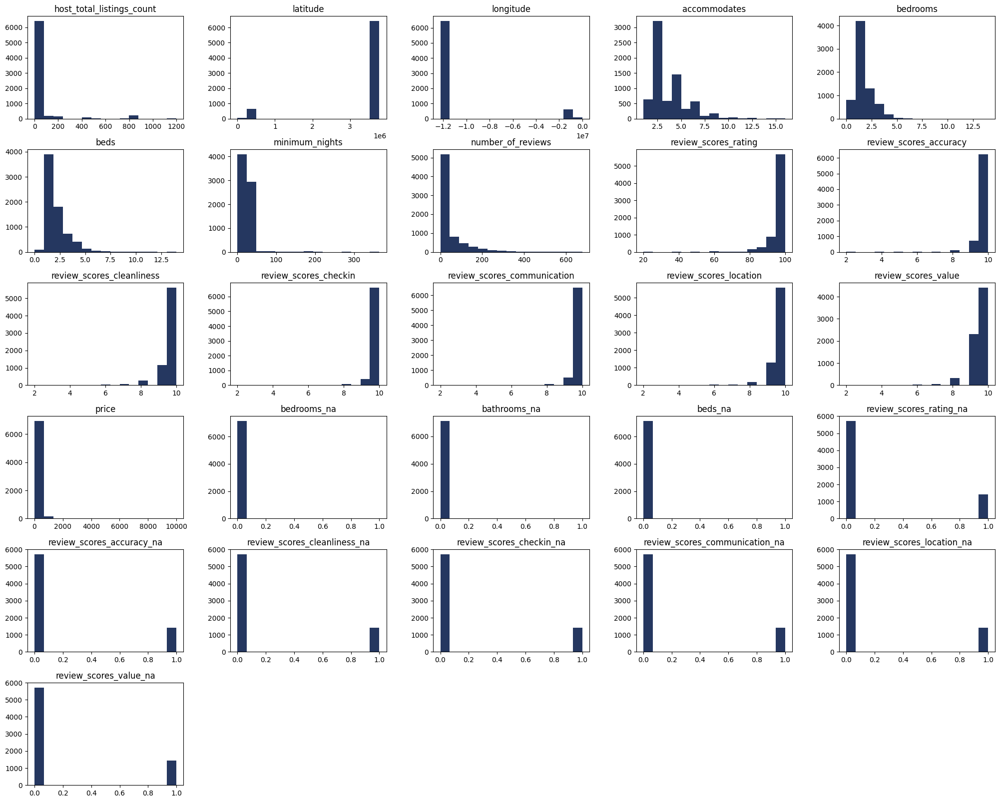

In [8]:
df_airbnb.hist(bins=15, figsize=(25, 20), grid=False, color="#253760");

#### **Verificação de Outliers** 
***Outliers*** podem influenciar a análise de dados, já que, por serem valores que se diferenciam significativamente do restante dos dados de um *dataset*, podem influenciar a análise para um viés que não represente a realidade da melhor forma. 

Sendo assim, pela distribuição dos histogramas, é possível verificar indícios da presença de valores atípicos, como na variável `price`. Além disso, as variáveis de latitude e longitude parecem apresentar valores inconsistentes com valores que representam esse tipo de informação. 

Em relação a variável price, serão realizadas duas verificações rápidas para detectação de *outliers*:
 - Resumo estatístico pelo método `describe()`;
 - Análise por meio do `boxplot` das variáveis.
 
As variáveis de longitude e latitude serão tratadas posteriormente.

#### Resumo estatístico pelo método `describe()`:

In [9]:
pd.set_option('display.max_columns', None)
df_airbnb.describe()

,host_total_listings_count,latitude,longitude,accommodates,bedrooms,beds,minimum_nights,number_of_reviews,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,price,bedrooms_na,bathrooms_na,beds_na,review_scores_rating_na,review_scores_accuracy_na,review_scores_cleanliness_na,review_scores_checkin_na,review_scores_communication_na,review_scores_location_na,review_scores_value_na
count,7146.000000,7.146000e+03,7.146000e+03,7146.000000,7146.000000,7146.000000,7146.000000,7146.000000,7146.000000,7146.000000,7146.000000,7146.000000,7146.000000,7146.000000,7146.000000,7146.000000,7146.000000,7146.000000,7146.000000,7146.000000,7146.000000,7146.000000,7146.000000,7146.000000,7146.000000,7146.000000
mean,52.604954,3.430809e+06,-1.114719e+07,3.201092,1.342709,1.764484,15.817800,43.553876,96.034285,9.820319,9.699552,9.895886,9.872796,9.719144,9.524349,213.309824,0.000280,0.002939,0.000980,0.198853,0.199412,0.199272,0.199692,0.199132,0.199692,0.199832
std,177.428653,1.033566e+06,3.319669e+06,1.914916,0.932855,1.176789,22.511624,72.538481,6.286139,0.601990,0.703877,0.448704,0.522599,0.659253,0.751603,311.375499,0.016728,0.054134,0.031285,0.399165,0.399586,0.399481,0.399797,0.399376,0.399797,0.399902
min,0.000000,3.772000e+01,-1.225131e+07,1.000000,0.000000,0.000000,1.000000,0.000000,20.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,10.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,1.000000,3.774272e+06,-1.224408e+07,2.000000,1.000000,1.000000,2.000000,1.000000,95.000000,10.000000,10.000000,10.000000,10.000000,10.000000,9.000000,100.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,2.000000,3.776318e+06,-1.224227e+07,2.000000,1.000000,1.000000,4.000000,11.000000,98.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,150.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,8.000000,3.778220e+06,-1.224077e+07,4.000000,2.000000,2.000000,30.000000,54.000000,99.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,235.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,1199.000000,3.781031e+06,-1.223900e+02,16.000000,14.000000,14.000000,365.000000,677.000000,100.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10000.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


Pelo resumo estatístico, em relação a variável price, nota-se que:
- **Contagem (count):** Existem 7.146 entradas de preços, o que sugere um conjunto de dados de tamanho considerável, e todos os valores de preço do dataset são válidos, uma vez que o número de valores válidos e o número total de linhas do dataset são o mesmo.
- **Média (mean):** O preço médio listado é aproximadamente 213,30 dólares. Isso é uma média de todos os preços listados e pode ser influenciada por valores muito altos ou muito baixos.
- **Desvio Padrão (std):** O desvio padrão é de aproximadamente 311,37 dólares, indicando que há uma variação significativa nos preços. Um desvio padrão mais alto sugere que os preços não estão agrupados de perto em torno da média.
- **Mínimo (min):** O preço mais baixo listado é 10 dólares, o que é **bastante** acessível.
- **Primeiro Quartil (25%):** 25% dos preços estão abaixo de 100 dólares, o que pode indicar uma gama de opções acessíveis na lista.
- **Mediana (50%):** A mediana dos preços é 150 dólares. Como a mediana é menos sensível a valores extremos do que a média, isso pode ser uma melhor representação do 'preço típico'.
- **Terceiro Quartil (75%):** 75% dos preços estão abaixo de 235 dólares. Isso mostra que a maioria das listagens tem um preço abaixo desse valor.
- **Máximo (max):** O preço mais alto listado é 10.000 dólares, o que é excepcionalmente alto comparado ao restante dos dados e sugere a presença de outliers.

#### Boxplot para `price`:

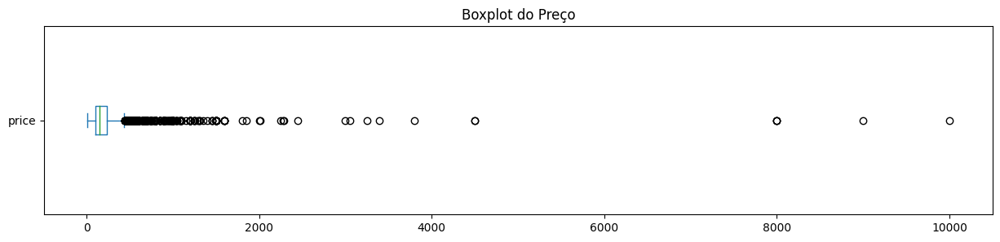

In [10]:
df_airbnb['price'].plot(kind='box', vert=False, figsize=(15,3))
plt.title('Boxplot do Preço')
plt.show()

#### **Lidando com outliers:**

Para lidar com outliers, podemos calcular o intervalo interquartílico (IQR), que é a diferença entre o terceiro e o primeiro quartil, para avaliar a dispersão dos dados centrais e identificar outliers. Outliers são frequentemente definidos como valores abaixo de Q1 - 1.5 * IQR ou acima de Q3 + 1.5 * IQR.

In [11]:
Q1 = df_airbnb['price'].quantile(0.25)
Q3 = df_airbnb['price'].quantile(0.75)
IQR = Q3 - Q1

lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

print(f"Limite inferior: {lower_bound} \nLimite superior: {upper_bound}")

Limite inferior: -102.5 
Limite superior: 437.5


O intervalo interquartílico (IQR), (que é, como dito anteriormente, a diferença entre o terceiro quartil e o primeiro quartil), é de 135 dólares (235 - 100), indicando a faixa de preço dentro da qual a maioria dos dados se encontra. 

Valores acima de **100 + 1.5 × IQR** ou abaixo de **100 − 1.5 × IQR** seriam considerados outliers. Com base nesses cálculos, os valores acima de **437,50** dólares poderiam ser considerados outliers. A presença de um valor máximo de 10.000 dólares confirma que há outliers significativos afetando a média.

Obs: Um valor de **-102,5** dólares não faz sentido no contexto de preços, pois não podemos ter um preço negativo. Isso significa que, de acordo com este método de detecção de outliers, não há outliers pequenos em termos de preços baixos no conjunto de dados. Todos os valores de 'price' acima de zero e abaixo do primeiro quartil são considerados normais nesse contexto.

In [12]:
df_clean = df_airbnb.copy()

df_clean = df_clean[(df_clean['price'] >= lower_bound) & (df_clean['price'] <= upper_bound)]

original_shape = df_airbnb.shape
filtered_shape = df_clean.shape

print(f'Tamanho do Dataset antes da limpeza: ', original_shape)
print(f'Tamanho do Dataset após a limpeza: ', filtered_shape)

Tamanho do Dataset antes da limpeza:  (7146, 34)
Tamanho do Dataset após a limpeza:  (6578, 34)


#### Comparação de distribuição pelos histogramas após remoção de outliers:

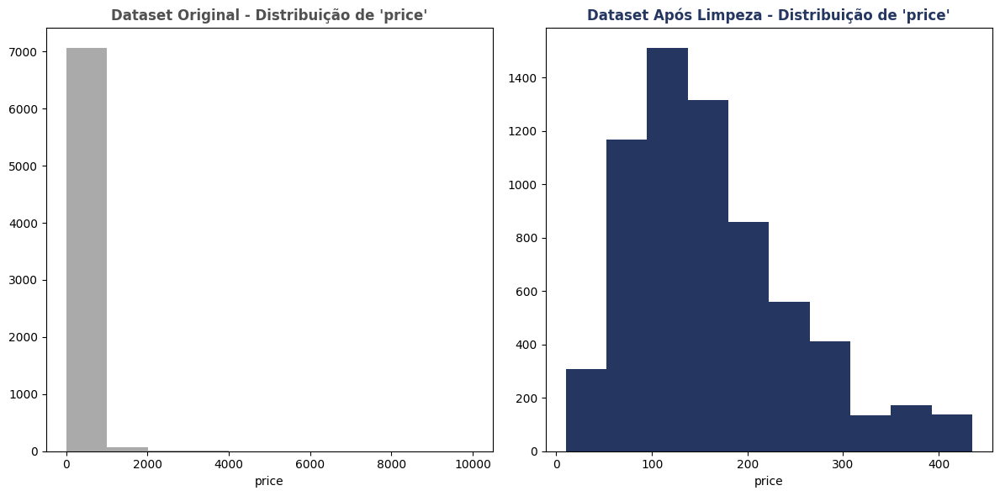

In [13]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))

ax1.hist(df_airbnb['price'], bins=10, color="#AAAAAA")
ax1.set_title("Dataset Original - Distribuição de 'price'", color="#515151", fontweight='bold')
ax1.set_xlabel('price')
ax1.grid(False)

ax2.hist(df_clean['price'], bins=10, color="#253760")
ax2.set_title("Dataset Após Limpeza - Distribuição de 'price'", color="#253760", fontweight='bold')
ax2.set_xlabel('price')
ax2.grid(False)

plt.tight_layout()
plt.show()


In [14]:
df_clean.describe()

,host_total_listings_count,latitude,longitude,accommodates,bedrooms,beds,minimum_nights,number_of_reviews,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,price,bedrooms_na,bathrooms_na,beds_na,review_scores_rating_na,review_scores_accuracy_na,review_scores_cleanliness_na,review_scores_checkin_na,review_scores_communication_na,review_scores_location_na,review_scores_value_na
count,6578.000000,6.578000e+03,6.578000e+03,6578.000000,6578.000000,6578.000000,6578.000000,6578.000000,6578.000000,6578.000000,6578.000000,6578.000000,6578.000000,6578.000000,6578.000000,6578.000000,6578.000000,6578.000000,6578.000000,6578.000000,6578.000000,6578.000000,6578.000000,6578.000000,6578.000000,6578.000000
mean,56.444968,3.428587e+06,-1.113869e+07,2.954545,1.223472,1.633931,16.385223,45.733810,95.891456,9.813621,9.687291,9.893737,9.868501,9.711614,9.525540,161.932806,0.000152,0.003192,0.001064,0.200669,0.201277,0.201125,0.201581,0.200973,0.201581,0.201733
std,183.972263,1.036336e+06,3.331590e+06,1.621535,0.802487,1.017447,22.460012,74.750606,6.428168,0.617457,0.721291,0.454518,0.527379,0.669037,0.757127,85.017300,0.012330,0.056416,0.032606,0.400531,0.400985,0.400872,0.401211,0.400758,0.401211,0.401324
min,0.000000,3.772000e+01,-1.225131e+07,1.000000,0.000000,0.000000,1.000000,0.000000,20.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,10.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,1.000000,3.774172e+06,-1.224411e+07,2.000000,1.000000,1.000000,2.000000,1.000000,95.000000,10.000000,10.000000,10.000000,10.000000,10.000000,9.000000,99.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,2.000000,3.776281e+06,-1.224223e+07,2.000000,1.000000,1.000000,4.000000,12.000000,98.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,147.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,9.000000,3.778116e+06,-1.224076e+07,4.000000,2.000000,2.000000,30.000000,59.000000,99.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,200.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,1199.000000,3.781031e+06,-1.224100e+02,15.000000,14.000000,14.000000,365.000000,677.000000,100.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,435.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


#### **Lidando com escalas erradas:**

Como mencionado anteriormente, os campos de latitude e longitude parecem conter valores inconsistentes para esse tipo de dado. Como sabemos:

> Latitude: A latitude varia de 0° no Equador até +90° no Polo Norte e -90° no Polo Sul.

> Longitude: A longitude varia de 0° em Greenwich até +180° a leste e -180° a oeste.

> Cada grau pode ser subdividido em minutos (') e segundos ("), para uma medição mais precisa. Por exemplo, uma latitude pode ser expressa como 35° 15' 30", onde 35° são os graus, 15' são os minutos e 30" são os segundos.

In [15]:
df_clean[['latitude', 'longitude']]

,latitude,longitude
0,3776931.0,-12243386.0
1,3774511.0,-12242102.0
2,3776669.0,-1224525.0
3,3776487.0,-12245183.0
5,3778471.0,-12244555.0
...,...,...
7141,3774884.0,-1224283.0
7142,3780645.0,-12242109.0
7143,3778855.0,-1224311.0
7144,3778645.0,-12241458.0


Observando os valores acimas podemos perceber que de fato os valores não estão consistentes com o esperado. Esse problema pode ser atribuído a escala dos dados que não estão em conformidade. Para resolver o problema podemos realizar cálculos simples:

In [16]:
# Divindo ambos os valores por 10000 para alcançar a escala correta
df_clean.loc[:, 'latitude'] = df_clean['latitude'] / 10000
df_clean.loc[:, 'longitude'] = df_clean['longitude'] / 10000

df_clean[['latitude', 'longitude']]

,latitude,longitude
0,377.6931,-1224.3386
1,377.4511,-1224.2102
2,377.6669,-122.4525
3,377.6487,-1224.5183
5,377.8471,-1224.4555
...,...,...
7141,377.4884,-122.4283
7142,378.0645,-1224.2109
7143,377.8855,-122.4311
7144,377.8645,-1224.1458


Com essa pequena amostra podemos perceber que os dados mudaram a escala, mas nem todos estão corretos. Por exemplo, as primeira duas linhas contem valores 10 vezes maiores do que o correto, já a linha 3 está em conformidade. Dessa forma, vamos adotar a seguinte estratégia:

Vamos verificar quais valores estão fora dos limites superiores para latitude e longitude e, para esses, dividir por 10:

In [17]:
correction_factor = 10
df_clean.loc[:, 'longitude'] = df_clean.apply(
    lambda row: row['longitude'] / correction_factor if abs(row['longitude']) > 180 else row['longitude'],
    axis=1
)
df_clean.loc[:, 'latitude'] = df_clean.apply(
    lambda row: row['latitude'] / correction_factor if abs(row['latitude']) > 90 else row['latitude'],
    axis=1
)

df_clean = df_clean[
    (df_clean['latitude'].between(24.396308, 49.384358)) &
    (df_clean['longitude'].between(-125.000000, -66.934570))
]


df_clean[['latitude', 'longitude']]

,latitude,longitude
0,37.76931,-122.43386
1,37.74511,-122.42102
2,37.76669,-122.45250
3,37.76487,-122.45183
5,37.78471,-122.44555
...,...,...
7141,37.74884,-122.42830
7142,37.80645,-122.42109
7143,37.78855,-122.43110
7144,37.78645,-122.41458


Pronto, agora todos os valores de latitude e longitude devem estar em conformidade com os limites para esse tipo de dado. Podemos prosseguir!

#### **Lidando com variáveis numéricas:**

Existem diversas variáveis numéricas, abaixo temos uma listas das variáveis numéricas que se tratam de quantidade em valores inteiros que deveriam entar como int, mas não estão.

In [18]:
int_variables = [
    "host_total_listings_count",
    "accommodates",
    "bedrooms",
    "beds",
    "minimum_nights",
    "number_of_reviews",
    "review_scores_rating",
    "review_scores_accuracy",
    "review_scores_cleanliness",
    "review_scores_checkin",
    "review_scores_communication",
    "review_scores_location",
    "review_scores_value",
    "review_scores_rating_na",
    "review_scores_accuracy_na",
    "review_scores_cleanliness_na",
    "review_scores_checkin_na",
    "review_scores_communication_na",
    "review_scores_location_na",
    "review_scores_value_na",
    "bedrooms_na",
    "beds_na"
]


Com o código abaixo é possível converter toda essa lista de variáveis em variáveis do tipo inteiro (int).

In [19]:
for var in int_variables:
    df_clean[var] = df_clean[var].astype(int)

df_clean.head()

,host_is_superhost,cancellation_policy,instant_bookable,host_total_listings_count,neighbourhood_cleansed,latitude,longitude,property_type,room_type,accommodates,bathrooms,bedrooms,beds,bed_type,minimum_nights,number_of_reviews,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,price,bedrooms_na,bathrooms_na,beds_na,review_scores_rating_na,review_scores_accuracy_na,review_scores_cleanliness_na,review_scores_checkin_na,review_scores_communication_na,review_scores_location_na,review_scores_value_na
0,t,moderate,t,1,Western Addition,37.76931,-122.43386,Apartment,Entire home/apt,3,1.0,1,2,Real Bed,1,180,97,10,10,10,10,10,10,170.0,0,0.0,0,0,0,0,0,0,0,0
1,f,strict_14_with_grace_period,f,2,Bernal Heights,37.74511,-122.42102,Apartment,Entire home/apt,5,1.0,2,3,Real Bed,30,111,98,10,10,10,10,10,9,235.0,0,0.0,0,0,0,0,0,0,0,0
2,f,strict_14_with_grace_period,f,10,Haight Ashbury,37.76669,-122.45250,Apartment,Private room,2,4.0,1,1,Real Bed,32,17,85,8,8,9,9,9,8,65.0,0,0.0,0,0,0,0,0,0,0,0
3,f,strict_14_with_grace_period,f,10,Haight Ashbury,37.76487,-122.45183,Apartment,Private room,2,4.0,1,1,Real Bed,32,8,93,9,9,10,10,9,9,65.0,0,0.0,0,0,0,0,0,0,0,0
5,f,moderate,f,1,Western Addition,37.78471,-122.44555,Apartment,Entire home/apt,6,1.0,2,3,Real Bed,2,31,90,9,8,10,10,9,9,255.0,0,0.0,0,0,0,0,0,0,0,0


#### **Lidando com variáveis booleanas:**

Como é possível perceber no dataframe, existem colunas que trazem valores de verdadeiro ou falso, como é o caso de 'host_is_superhost' e 'instant_bookable'. Porém, no dataframe essas variáveis estão como f e t, o que pode atrapalhar seu uso. Para corrigir isso, o código abaixo substitui t por 1 e f por 0 em todas as linhas dessas colunas, além de definir seu tipo como bool.

In [20]:
print("Tamanho do DataFrame antes da conversão das variáveis binárias:", df_clean.shape)

binary_columns = ['host_is_superhost', 'instant_bookable']
for col in binary_columns:
    df_clean[col] = df_clean[col].map({'t': 1, 'f': 0})

print("Tamanho do DataFrame após a conversão das variáveis binárias:", df_clean.shape)

df_clean.head()

Tamanho do DataFrame antes da conversão das variáveis binárias: (6444, 34)
Tamanho do DataFrame após a conversão das variáveis binárias: (6444, 34)


,host_is_superhost,cancellation_policy,instant_bookable,host_total_listings_count,neighbourhood_cleansed,latitude,longitude,property_type,room_type,accommodates,bathrooms,bedrooms,beds,bed_type,minimum_nights,number_of_reviews,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,price,bedrooms_na,bathrooms_na,beds_na,review_scores_rating_na,review_scores_accuracy_na,review_scores_cleanliness_na,review_scores_checkin_na,review_scores_communication_na,review_scores_location_na,review_scores_value_na
0,1,moderate,1,1,Western Addition,37.76931,-122.43386,Apartment,Entire home/apt,3,1.0,1,2,Real Bed,1,180,97,10,10,10,10,10,10,170.0,0,0.0,0,0,0,0,0,0,0,0
1,0,strict_14_with_grace_period,0,2,Bernal Heights,37.74511,-122.42102,Apartment,Entire home/apt,5,1.0,2,3,Real Bed,30,111,98,10,10,10,10,10,9,235.0,0,0.0,0,0,0,0,0,0,0,0
2,0,strict_14_with_grace_period,0,10,Haight Ashbury,37.76669,-122.45250,Apartment,Private room,2,4.0,1,1,Real Bed,32,17,85,8,8,9,9,9,8,65.0,0,0.0,0,0,0,0,0,0,0,0
3,0,strict_14_with_grace_period,0,10,Haight Ashbury,37.76487,-122.45183,Apartment,Private room,2,4.0,1,1,Real Bed,32,8,93,9,9,10,10,9,9,65.0,0,0.0,0,0,0,0,0,0,0,0
5,0,moderate,0,1,Western Addition,37.78471,-122.44555,Apartment,Entire home/apt,6,1.0,2,3,Real Bed,2,31,90,9,8,10,10,9,9,255.0,0,0.0,0,0,0,0,0,0,0,0


#### **Lidando com linhas sem formatação:**

Na coluna 'cancellation_policy' é possível notar que as informações sobre a política de cancelamento de cada propriedade estão sem formatação. Para resolver, o código abaixo substitui underscore/underline (_) por espaços e também define que a primeira letra deve ser maiúscula

In [21]:
def reformat_cancellation_policy(value):
    return value.replace("_", " ").title()

df_clean['cancellation_policy'] = df_clean['cancellation_policy'].apply(reformat_cancellation_policy)

df_clean.head()

,host_is_superhost,cancellation_policy,instant_bookable,host_total_listings_count,neighbourhood_cleansed,latitude,longitude,property_type,room_type,accommodates,bathrooms,bedrooms,beds,bed_type,minimum_nights,number_of_reviews,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,price,bedrooms_na,bathrooms_na,beds_na,review_scores_rating_na,review_scores_accuracy_na,review_scores_cleanliness_na,review_scores_checkin_na,review_scores_communication_na,review_scores_location_na,review_scores_value_na
0,1,Moderate,1,1,Western Addition,37.76931,-122.43386,Apartment,Entire home/apt,3,1.0,1,2,Real Bed,1,180,97,10,10,10,10,10,10,170.0,0,0.0,0,0,0,0,0,0,0,0
1,0,Strict 14 With Grace Period,0,2,Bernal Heights,37.74511,-122.42102,Apartment,Entire home/apt,5,1.0,2,3,Real Bed,30,111,98,10,10,10,10,10,9,235.0,0,0.0,0,0,0,0,0,0,0,0
2,0,Strict 14 With Grace Period,0,10,Haight Ashbury,37.76669,-122.45250,Apartment,Private room,2,4.0,1,1,Real Bed,32,17,85,8,8,9,9,9,8,65.0,0,0.0,0,0,0,0,0,0,0,0
3,0,Strict 14 With Grace Period,0,10,Haight Ashbury,37.76487,-122.45183,Apartment,Private room,2,4.0,1,1,Real Bed,32,8,93,9,9,10,10,9,9,65.0,0,0.0,0,0,0,0,0,0,0,0
5,0,Moderate,0,1,Western Addition,37.78471,-122.44555,Apartment,Entire home/apt,6,1.0,2,3,Real Bed,2,31,90,9,8,10,10,9,9,255.0,0,0.0,0,0,0,0,0,0,0,0


#### **Lidando com problemas em valores flutuantes:**

Anteriormente foi citado que existem variáveis numéricas que se tratam de quantidade inteiras e, por isso, deveriam ser representadas por números inteiros. Dessa forma, é possível observar que a variável 'bathrooms' não entrou na lista de variáveis a serem convertidas. Mas por que?

Isso acontece pois 1,5 significa um banheiro completo e um lavabo, enquanto 2,5 indica dois banheiros completos e um lavabo. No entanto, foi identificado uma inconsistência: valores fracionários, como 1.5 ou 2.5, estão sendo interpretados erroneamente como datas. Por exemplo, 1.5 está sendo convertido para 01/05/2022 00:00:00, 2.5 para 02/05/2022 00:00:00, e assim por diante. É necessário corrigir esse erro de interpretação dos dados e o código abaixo realiza essa função.

In [22]:
def corrigir_bathrooms(valor):
    if isinstance(valor, datetime.datetime):
        return valor.month + 0.5
    else:
        return float(valor)

df_clean['bathrooms'] = df_clean['bathrooms'].apply(corrigir_bathrooms)
df_clean

,host_is_superhost,cancellation_policy,instant_bookable,host_total_listings_count,neighbourhood_cleansed,latitude,longitude,property_type,room_type,accommodates,bathrooms,bedrooms,beds,bed_type,minimum_nights,number_of_reviews,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,price,bedrooms_na,bathrooms_na,beds_na,review_scores_rating_na,review_scores_accuracy_na,review_scores_cleanliness_na,review_scores_checkin_na,review_scores_communication_na,review_scores_location_na,review_scores_value_na
0,1,Moderate,1,1,Western Addition,37.76931,-122.43386,Apartment,Entire home/apt,3,1.0,1,2,Real Bed,1,180,97,10,10,10,10,10,10,170.0,0,0.0,0,0,0,0,0,0,0,0
1,0,Strict 14 With Grace Period,0,2,Bernal Heights,37.74511,-122.42102,Apartment,Entire home/apt,5,1.0,2,3,Real Bed,30,111,98,10,10,10,10,10,9,235.0,0,0.0,0,0,0,0,0,0,0,0
2,0,Strict 14 With Grace Period,0,10,Haight Ashbury,37.76669,-122.45250,Apartment,Private room,2,4.0,1,1,Real Bed,32,17,85,8,8,9,9,9,8,65.0,0,0.0,0,0,0,0,0,0,0,0
3,0,Strict 14 With Grace Period,0,10,Haight Ashbury,37.76487,-122.45183,Apartment,Private room,2,4.0,1,1,Real Bed,32,8,93,9,9,10,10,9,9,65.0,0,0.0,0,0,0,0,0,0,0,0
5,0,Moderate,0,1,Western Addition,37.78471,-122.44555,Apartment,Entire home/apt,6,1.0,2,3,Real Bed,2,31,90,9,8,10,10,9,9,255.0,0,0.0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7141,0,Flexible,1,18,Noe Valley,37.74884,-122.42830,House,Entire home/apt,3,1.0,1,2,Real Bed,30,0,98,10,10,10,10,10,10,163.0,0,0.0,0,1,1,1,1,1,1,1
7142,1,Flexible,1,10,Russian Hill,37.80645,-122.42109,Guest suite,Entire home/apt,2,1.0,0,1,Real Bed,1,0,98,10,10,10,10,10,10,160.0,0,0.0,0,1,1,1,1,1,1,1
7143,1,Flexible,1,10,Western Addition,37.78855,-122.43110,Apartment,Entire home/apt,4,1.0,1,1,Real Bed,2,0,98,10,10,10,10,10,10,249.0,0,0.0,0,1,1,1,1,1,1,1
7144,0,Flexible,1,87,Downtown/Civic Center,37.78645,-122.41458,Apartment,Entire home/apt,3,1.0,1,2,Real Bed,30,0,98,10,10,10,10,10,10,105.0,0,0.0,0,1,1,1,1,1,1,1


### Correlação existente entre as variáveis**

A correlação entre variáveis é uma medida estatística que indica o grau de relação linear entre duas ou mais variáveis. Ela avalia se os dados estão relacionados positivamente (aumentam ou diminuem juntos) ou negativamente (um aumenta enquanto o outro diminui).

A intensidade dessa relação pode variar de -1 a 1. Uma correlação próxima de 1 ou -1 indica uma forte relação, enquanto uma correlação próxima de 0 indica uma fraca ou nenhuma relação.

Para identificar se há correlações existentes entre as variáveis de interesse, utilizarei:
 - Matriz de correlação;
 - *Heatmap* a partir dessa matriz, usando a biblioteca `seaborn`.

In [23]:
df_numerico = df_clean.select_dtypes(include=['float64', 'int64', 'int'])

df_numerico = df_numerico.drop(['beds_na', 'bathrooms_na', 'bedrooms_na'], axis=1)

corr = df_numerico.corr()
display(corr)

,host_is_superhost,instant_bookable,host_total_listings_count,latitude,longitude,accommodates,bathrooms,bedrooms,beds,minimum_nights,number_of_reviews,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,price,review_scores_rating_na,review_scores_accuracy_na,review_scores_cleanliness_na,review_scores_checkin_na,review_scores_communication_na,review_scores_location_na,review_scores_value_na
host_is_superhost,1.000000,-0.097268,0.064023,-0.097697,-0.057576,-0.019390,0.016414,-0.005958,-0.037587,-0.196678,0.294596,0.200543,0.167325,0.187422,0.105385,0.126838,0.066139,0.114388,0.059960,-0.232348,-0.233373,-0.233117,-0.233885,-0.232861,-0.233885,-0.234141
instant_bookable,-0.097268,1.000000,-0.025805,0.013201,-0.012819,-0.054874,-0.041303,-0.073325,-0.061019,-0.049880,0.034515,-0.017604,-0.012531,-0.009532,0.011902,-0.004037,0.015968,0.022503,-0.108344,0.103079,0.101739,0.102074,0.101865,0.102409,0.101865,0.101531
host_total_listings_count,0.064023,-0.025805,1.000000,0.181986,0.185864,0.001046,-0.039851,-0.015310,-0.051484,0.170813,-0.172141,0.032579,0.024394,0.054459,0.003382,-0.013186,0.027485,0.045780,0.081573,0.315503,0.314674,0.314882,0.314264,0.315089,0.314264,0.314060
latitude,-0.097697,0.013201,0.181986,1.000000,0.186017,-0.078526,0.002650,-0.156385,-0.080010,0.163663,-0.108244,-0.022434,-0.027482,-0.013825,-0.045115,-0.045957,0.201877,-0.012163,0.149105,0.174475,0.173558,0.173714,0.173776,0.173907,0.173776,0.174152
longitude,-0.057576,-0.012819,0.185864,0.186017,1.000000,-0.082642,-0.020850,-0.108890,-0.086696,0.115769,-0.127316,0.012866,-0.008477,0.011238,-0.031335,-0.025455,-0.011654,0.016663,0.072674,0.130015,0.129071,0.129153,0.128300,0.130062,0.128300,0.128081
accommodates,-0.019390,-0.054874,0.001046,-0.078526,-0.082642,1.000000,0.212530,0.697772,0.822696,0.004147,-0.054658,0.038587,0.015366,0.001148,0.008433,0.015150,0.013500,-0.027989,0.564806,-0.020565,-0.020024,-0.020278,-0.020467,-0.020056,-0.020467,-0.020688
bathrooms,0.016414,-0.041303,-0.039851,0.002650,-0.020850,0.212530,1.000000,0.302993,0.239208,0.019673,-0.037096,-0.000712,-0.024001,-0.069305,-0.012365,-0.007789,-0.011156,-0.012072,0.127847,-0.015127,-0.014925,-0.015324,-0.013711,-0.015166,-0.013711,-0.013870
bedrooms,-0.005958,-0.073325,-0.015310,-0.156385,-0.108890,0.697772,0.302993,1.000000,0.675678,0.027777,-0.068761,0.067761,0.023598,0.003733,0.014124,0.012979,0.014901,0.002575,0.507886,-0.026112,-0.025549,-0.025931,-0.025750,-0.025831,-0.025750,-0.025850
beds,-0.037587,-0.061019,-0.051484,-0.080010,-0.086696,0.822696,0.239208,0.675678,1.000000,0.037427,-0.059114,0.006995,-0.010973,-0.055886,-0.012267,-0.003188,-0.002605,-0.037955,0.440564,-0.024909,-0.024706,-0.024852,-0.025173,-0.024618,-0.025173,-0.025406
minimum_nights,-0.196678,-0.049880,0.170813,0.163663,0.115769,0.004147,0.019673,0.027777,0.037427,1.000000,-0.252951,-0.082060,-0.098915,-0.084951,-0.108129,-0.108704,-0.025960,-0.052763,-0.051644,0.275478,0.276644,0.276487,0.276455,0.275810,0.276455,0.276612


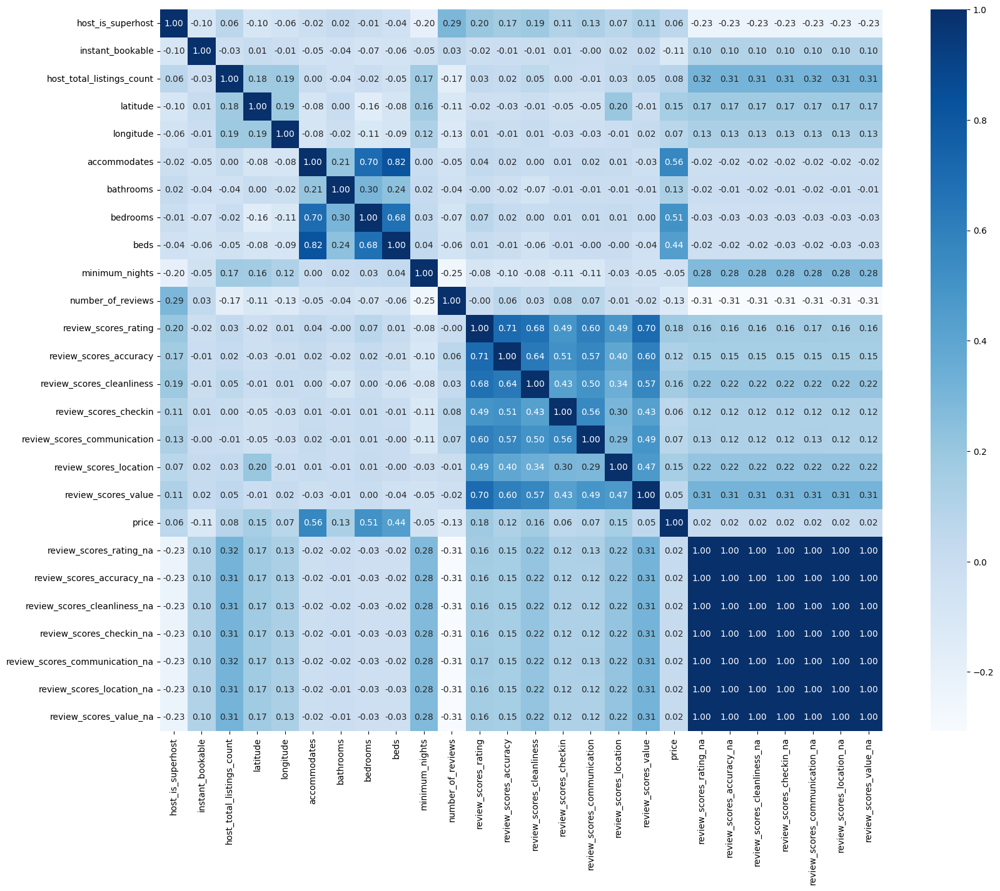

In [24]:
plt.figure(figsize=(20, 15))
sns.heatmap(corr, cmap='Blues', fmt='.2f', square=True, linecolor='white', annot=True)
plt.show()

### **Tipo de imóvel mais alugado no Airbnb**

In [25]:
tipos_unicos = df_clean['room_type'].unique()
print(tipos_unicos)

['Entire home/apt' 'Private room' 'Shared room']


A coluna `room_type` refere-se ao tipo de acomodação disponível para aluguel anunciado no Airbnb. Essa variável indica o estilo ou categoria do espaço que está sendo oferecido, podendo ser:
 - *Entire home/apt* (casa/apartamento inteiro) 
 - *Private room* (quarto privativo)
 - *Shared room* (quarto compartilhado)

Text(0.5, 1.0, 'Porcentagem dos Tipos de Imóveis')

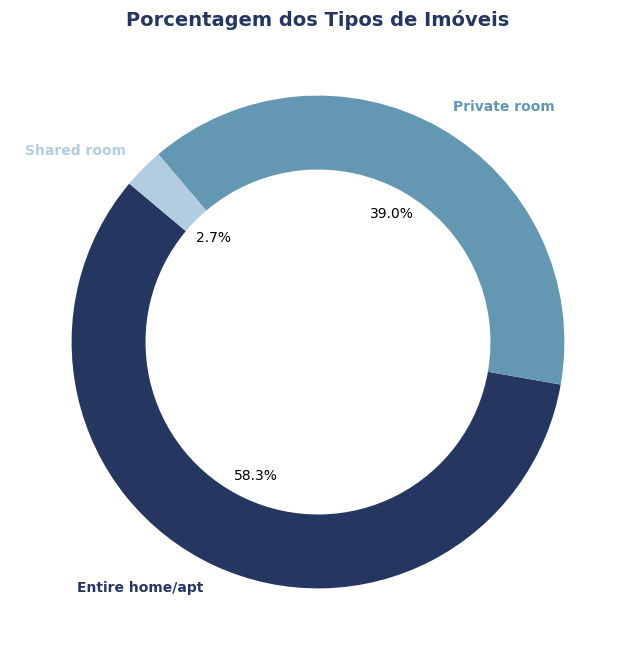

In [26]:
cores = ["#253760", "#6497b1", "#b3cde0"]

porcentagem = df_clean.room_type.value_counts() / df_clean.shape[0]

categorias_principais = ['Entire home/apt', 'Private room', 'Shared room']

porcentagem_filtrada = porcentagem[categorias_principais]

porcentagem_outros = porcentagem.drop(categorias_principais).sum()
if porcentagem_outros > 0:
    porcentagem_filtrada['Outros'] = porcentagem_outros

while len(cores) < len(porcentagem_filtrada):
    cores.extend(cores)

imoveis = porcentagem_filtrada.index.tolist()

fig, ax = plt.subplots(figsize=(12, 8))
fatias, legendas, rotulos = ax.pie(porcentagem_filtrada, labels=imoveis, autopct='%1.1f%%', colors=cores, startangle=140, wedgeprops=dict(width=0.3))

for i, legenda in enumerate(legendas):
    legenda.set_color(cores[i])
    legenda.set_fontweight('bold')

for rotulo in rotulos:
    rotulo.set_color('black')

# Título
ax.set_title('Porcentagem dos Tipos de Imóveis', color="#253760", fontsize=14, fontweight='bold')

Nota-se que:
 - Quase 60% dos aluguéis do Airbnb, em San Francisco, são de casas ou apartamentos inteiros;
 
 - Aproximadamente 39% das propriedades são quartos privativos;
 
 - Quartos compartilhados representam 2.7% dos tipos de aluguéis de San Francisco no Airbnb.
 
Obs: Optei por utilizar um gráfico de rosca devido às quantidades de tipos de quartos, apenas 3 categorias, dessa forma, fica bem visível as divisões e o gráfico de rosca não se torna um problema.

### **Localidades mais caras do dataset e quantidade de imóveis para alugar por região**


In [27]:
# top 5 localidades com maiores médias de preços
top_5_preco = df_clean.groupby(['neighbourhood_cleansed']).price.mean().nlargest(5).sort_values(ascending=True)
top_5_preco

neighbourhood_cleansed
Castro/Upper Market    185.346705
Noe Valley             185.530249
Diamond Heights        185.611111
Marina                 192.089744
Russian Hill           200.450820
Name: price, dtype: float64

In [28]:
# top 5 localidades com quantidades mais elevadas de imóveis 
top_5_qtde = df_clean['neighbourhood_cleansed'].value_counts().nlargest(5).sort_values(ascending=True)
top_5_qtde

Castro/Upper Market      349
Downtown/Civic Center    497
Western Addition         530
South of Market          549
Mission                  629
Name: neighbourhood_cleansed, dtype: int64

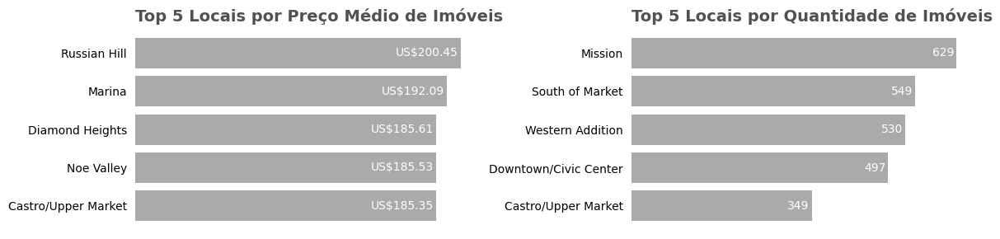

In [29]:
cinza, cinza2 = "#AAAAAA", "#515151"

fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, figsize=(12, 3))

top_5_preco.plot.barh(color=cinza, width=0.8, ax=ax1)
ax1.set_title('Top 5 Locais por Preço Médio de Imóveis', loc='left', fontsize=14, color=cinza2, fontweight='bold')
ax1.set_ylabel('')

for rect in ax1.patches:
    width = rect.get_width()
    ax1.annotate(f'US${width:.2f}', xy=(rect.get_x() + rect.get_width(), 
                                      rect.get_y() + rect.get_height() / 2),
                 xytext=(-2, -5), 
                 textcoords='offset points',
                 ha='right', 
                 va='bottom', 
                 color='white')
    
ax1.spines['right'].set_visible(False)
ax1.spines['left'].set_visible(False)
ax1.spines['top'].set_visible(False)
ax1.spines['bottom'].set_visible(False)

ax1.tick_params(left=False)

ax1.get_xaxis().set_visible(False)

top_5_qtde.plot.barh(color=cinza, width=0.8, ax=ax2)
ax2.set_title('Top 5 Locais por Quantidade de Imóveis', loc='left', fontsize=14, color=cinza2, fontweight='bold')

for rect in ax2.patches:
    width = rect.get_width()
    ax2.annotate(f'{width}', xy=(rect.get_x() + rect.get_width(), 
                                 rect.get_y() + rect.get_height() / 2),
                 xytext=(-2, 0), 
                 textcoords='offset points',
                 ha='right', 
                 va='center', 
                 color='white')

ax2.spines['right'].set_visible(False)
ax2.spines['left'].set_visible(False)
ax2.spines['top'].set_visible(False)
ax2.spines['bottom'].set_visible(False)

ax2.tick_params(left=False)

ax2.get_xaxis().set_visible(False)

plt.tight_layout()
plt.show()

Em relação ao `neighbourhood_cleansed`, variável correspondente aos bairros de San Francisco, verificou-se que:

- Russian Hill é o bairro com o preço médio mais alto para aluguéis no Airbnb, com um custo de US$200,45. Isso pode refletir uma grande demanda por suas características únicas, como vistas para a baía e a proximidade com ícones turísticos. Apesar dos preços elevados, Russian Hill não está entre os bairros com o maior número de imóveis listados, o que pode sugerir uma oferta mais limitada de propriedades ou uma exclusividade do bairro.

- Marina, Diamond Heights, Noe Valley e Castro/Upper Market seguem Russian Hill em termos de preço médio, todos acima de US$185,00. Esses valores indicam que essas áreas também são consideradas desejáveis para estadias temporárias, talvez devido a uma combinação de localização privilegiada, amenidades e características de bairro.

- Por outro lado, o bairro Mission lidera o ranking em quantidade de imóveis disponíveis, com 629 listagens. Isso sugere que o Mission é um hotspot para visitantes do Airbnb, possivelmente devido à sua vibrante cultura, gastronomia e vida noturna, além de ser um bairro tradicionalmente mais acessível em San Francisco.

- South of Market e Western Addition também possuem um número significativo de imóveis listados, mostrando que são locais populares para aluguéis de curta duração. Estes bairros podem oferecer conveniências como proximidade ao centro da cidade e atrações locais, além de possuírem uma diversidade de tipos de imóveis.

- Interessante notar que Castro/Upper Market figura em ambos os rankings, o que aponta para uma procura equilibrada em termos de preço e disponibilidade. Este equilíbrio pode ser atraente tanto para locadores quanto para locatários, indicando uma área com boa rotatividade no mercado de aluguéis de curta duração.

-> Estes dados sugerem uma diversidade no mercado de aluguéis de curta duração em San Francisco, com bairros atendendo a diferentes nichos de preço e demanda. Bairros com preços médios mais altos podem oferecer características únicas ou luxuosas, enquanto aqueles com maior quantidade de imóveis podem ser mais acessíveis ou ter uma maior oferta de propriedades.

### **Mapa de Calor dos Preços dos Imóveis de San Francisco no Airbnb**

Visto que são fornecidas a `latitude` e `longitude` dos imóveis, é possível plotar um *heatmap* das preços de aluguéis das propriedades de San Francisco.

Abaixo, pode-se verificar a diversidade sugerida acima, uma vez que as cores de pontos estão bem distribuídas.

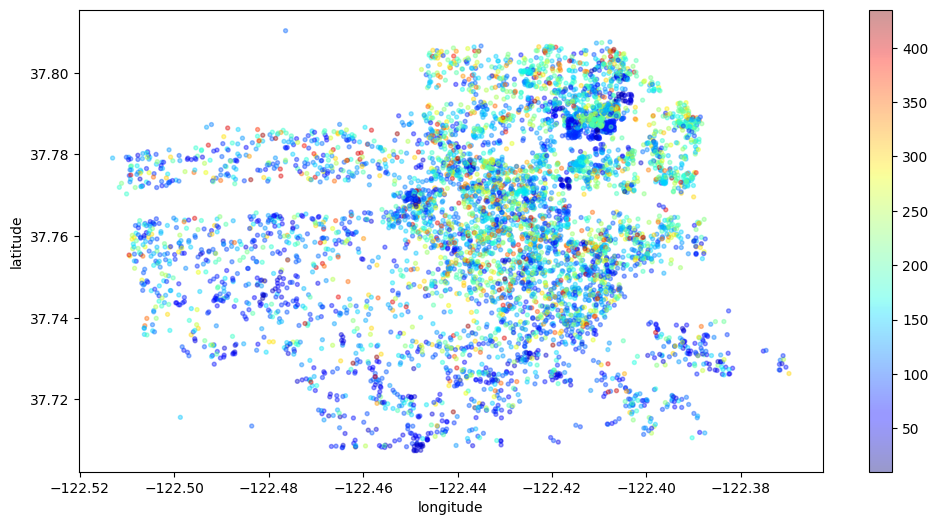

In [30]:
df_clean.plot(kind="scatter", 
              x='longitude', 
              y='latitude', 
              alpha=0.4, 
              c=df_clean['price'], 
              s=8,
              cmap=plt.get_cmap('jet'), 
              figsize=(12,6));

In [31]:
gdf_neighborhoods = gpd.read_file('shapefiles/neighbourhoods/city-of-san-francisco-california-neighborhoods.shp')

gdf_neighborhoods.head()

,SHAPE_Leng,NEIGHBORHO,GLOBALID,Area,Length,geometry
0,0.087187,Mission,{50D5BCF3-EE7D-4222-9F9A-2369E4BB31DC},NaN,NaN,"POLYGON ((-122.42476 37.74785, -122.42495 37.7..."
1,0.059722,Downtown/Civic Center,{25DB5DF4-DE12-457A-86FF-68A61CEE59FA},NaN,NaN,"POLYGON ((-122.40891 37.79013, -122.40880 37.7..."
2,0.377676,Bayview,{360F5CF4-7127-49D2-92A9-BE9A04B0B1A3},NaN,NaN,"MULTIPOLYGON (((-122.38811 37.74780, -122.3881..."
3,0.071589,Crocker Amazon,{C2DC247E-DE56-48D4-BDFD-882B0BBD5C1B},NaN,NaN,"POLYGON ((-122.42085 37.70833, -122.42388 37.7..."
4,0.043166,Glen Park,{418AF9A8-481A-4CEA-A341-9FA4A8F381DD},NaN,NaN,"POLYGON ((-122.42418 37.74226, -122.42394 37.7..."


In [32]:
df_properties = df_clean.copy()
gdf_properties = gpd.GeoDataFrame(
    df_properties, 
    geometry=gpd.points_from_xy(df_properties.longitude, df_properties.latitude),
    crs="EPSG:4326"
)

In [33]:
average_price_per_neighborhood = gdf_properties.groupby('neighbourhood_cleansed')['price'].mean()
min_avg_price, max_avg_price = average_price_per_neighborhood.min(), average_price_per_neighborhood.max()
normalized_avg_prices = (average_price_per_neighborhood - min_avg_price) / (max_avg_price - min_avg_price)

neighborhood_to_avg_price = normalized_avg_prices.to_dict()

linear = cm.LinearColormap(['blue', 'green', 'yellow', 'red'], vmin=normalized_avg_prices.min(), vmax=normalized_avg_prices.max())

def get_color(value):
    """Retorna a cor correspondente ao valor normalizado."""
    return linear(value)

map_sf = folium.Map(location=[37.7749, -122.4194], zoom_start=12)

for _, row in gdf_properties.iterrows():
    neighborhood = row['neighbourhood_cleansed']
    color = get_color(neighborhood_to_avg_price.get(neighborhood, 0.0))
    popup_text = f"Neighborhood: {neighborhood}, Property Type: {row['property_type']}, Bedrooms: {row['bedrooms']}, Price: ${row['price']}"
    popup = folium.Popup(popup_text, max_width=300)
    folium.CircleMarker(
        location=(row['latitude'], row['longitude']), 
        radius=5, 
        color=color, 
        fill=True, 
        fill_color=color, 
        fill_opacity=0.7,
        popup=popup
    ).add_to(map_sf)

map_sf

### **Distribuição geoespacial das propriedades de San Francisco no Airbnb**
O gráfico criado com a biblioteca ***Folium*** mostra a distribuição geográfica das propriedades em San Francisco com base nas coordenadas das variáveis `latitude` e `longitude`. Essa visualização tem como proposta fornecer uma representação espacial dos dados, permitindo identificar áreas com maior concentração de propriedades e explorar a distribuição geográfica dos imóveis em San Francisco.

Abaixo, percebe-se que:
 - Assim como representado no gráfico de barras em ranking, `Mission` é o bairro com a maior concentração de imóveis em San Francisco, California.

In [34]:
neighborhoods = gdf_properties['neighbourhood_cleansed'].unique()
palette = sns.color_palette("husl", n_colors=len(neighborhoods))
colors = [mpl.colors.rgb2hex(color) for color in palette]
color_map = {neighborhood: colors[i] for i, neighborhood in enumerate(neighborhoods)}

In [35]:
map_sf = folium.Map(location=[37.7749, -122.4194], zoom_start=12)

folium.GeoJson(
    gdf_neighborhoods.to_json(),
    name='Neighborhoods',
    style_function=lambda x: {'fillColor': 'grey', 'color': 'black', 'weight': 1}
).add_to(map_sf)

for _, row in gdf_properties.iterrows():
    neighborhood = row['neighbourhood_cleansed']
    popup_text = (f"Neighborhood: {neighborhood}<br>"
                  f"Property Type: {row['property_type']}<br>"
                  f"Price: ${row['price']}")
    popup = folium.Popup(popup_text, max_width=300)
    folium.CircleMarker(
        location=(row['latitude'], row['longitude']), 
        radius=5, 
        color=color_map[neighborhood], 
        fill=True, 
        fill_color=color_map[neighborhood], 
        fill_opacity=0.7,
        popup=popup
    ).add_to(map_sf)

map_sf

### **Distribuição geoespacial das propriedades e pontos turísticos de San Francisco no Airbnb**

In [36]:
gdf_landmarks = gpd.read_file('shapefiles/landmarks/attraction_point.shp')

gdf_landmarks.head()

,tourism,name,addr_stree,opening_ho,addr_house,addr_postc,website,name_en,phone,wikidata,addr_city,ele,email,addr_state,artist_nam,descriptio,fee,historic,name_ru,name_zh,operator,wheelchair,wikipedia,alt_name,amenity,contact_we,heritage,leisure,natural,start_date,geometry
0,attraction,Alamo Square Historic District,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,61,NaN,NaN,NaN,NaN,NaN,district,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8,NaN,NaN,NaN,POINT (-122.43497 37.77715)
1,attraction,Alcatraz Island,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,恶魔岛，夺命岛,NaN,yes,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (-122.42306 37.82706)
2,attraction,Bank of Canton (former Chinese Telephone Excha...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (-122.40627 37.79507)
3,attraction,Bay Cruise Line,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (-122.41137 37.80889)
4,attraction,Bradford Street,Bradford Street,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (-122.40971 37.73733)


In [37]:
gdf_landmarks = gdf_landmarks.dropna(subset=['name'])
gdf_landmarks.head()

,tourism,name,addr_stree,opening_ho,addr_house,addr_postc,website,name_en,phone,wikidata,addr_city,ele,email,addr_state,artist_nam,descriptio,fee,historic,name_ru,name_zh,operator,wheelchair,wikipedia,alt_name,amenity,contact_we,heritage,leisure,natural,start_date,geometry
0,attraction,Alamo Square Historic District,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,61,NaN,NaN,NaN,NaN,NaN,district,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8,NaN,NaN,NaN,POINT (-122.43497 37.77715)
1,attraction,Alcatraz Island,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,恶魔岛，夺命岛,NaN,yes,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (-122.42306 37.82706)
2,attraction,Bank of Canton (former Chinese Telephone Excha...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (-122.40627 37.79507)
3,attraction,Bay Cruise Line,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (-122.41137 37.80889)
4,attraction,Bradford Street,Bradford Street,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (-122.40971 37.73733)


In [38]:
def landmark_style(feature):
    return {
        'fillColor': 'blue',
        'color': 'black',
        'weight': 1,
        'fillOpacity': 0.7
    }

neighborhoods = gdf_properties['neighbourhood_cleansed'].unique()
palette = sns.color_palette("husl", n_colors=len(neighborhoods))
colors = [mpl.colors.rgb2hex(color) for color in palette]
color_map = {neighborhood: colors[i] for i, neighborhood in enumerate(neighborhoods)}

map_sf = folium.Map(location=[37.7749, -122.4194], zoom_start=12)

folium.GeoJson(
    gdf_neighborhoods.to_json(),
    name='Neighborhoods',
    style_function=lambda x: {'fillColor': 'grey', 'color': 'black', 'weight': 1}
).add_to(map_sf)

folium.GeoJson(
    gdf_landmarks,
    name='Landmarks',
    style_function=landmark_style,
    tooltip=folium.features.GeoJsonTooltip(
        fields=['name'],
        aliases=['Atração: '],
        localize=True
    )
).add_to(map_sf)

for _, row in gdf_properties.iterrows():
    neighborhood = row['neighbourhood_cleansed']
    popup_text = (f"<b>Neighborhood:</b>{neighborhood}<br>"
                  f"<b>Property Type:</b> {row['property_type']}<br>"
                  f"<b>Room Type:</b> {row['room_type']}<br>"
                  f"<b>Cancellation Policy:</b> {row['cancellation_policy']}<br>"
                  f"<b>Minimum Nights:</b> {row['minimum_nights']}<br>"
                  f"<b>Review Scores Rating:</b> {row['review_scores_rating']}/100<br>"
                  f"<b>Price:</b> ${row['price']}<br>"
                 )
    popup = folium.Popup(popup_text, max_width=300)
    folium.CircleMarker(
        location=(row['latitude'], row['longitude']), 
        radius=5, 
        color=color_map[neighborhood], 
        fill=True, 
        fill_color=color_map[neighborhood], 
        fill_opacity=0.7,
        popup=popup
    ).add_to(map_sf)

map_sf

### **Média dos preços de aluguel**

In [39]:
# Média da coluna `price``
print(f'A média dos preços do aluguel é ${df_clean.price.mean():.2f}')

A média dos preços do aluguel é $161.90


### **Média do mínimo de noites para aluguel (minimum_nights)**

In [40]:
# ver a média da coluna `minimum_nights``
print(f'A média do mínimo de noites para aluguel em São Francisco é de {df_clean.minimum_nights.mean():.0f} noites.')

A média do mínimo de noites para aluguel em São Francisco é de 16 noites.


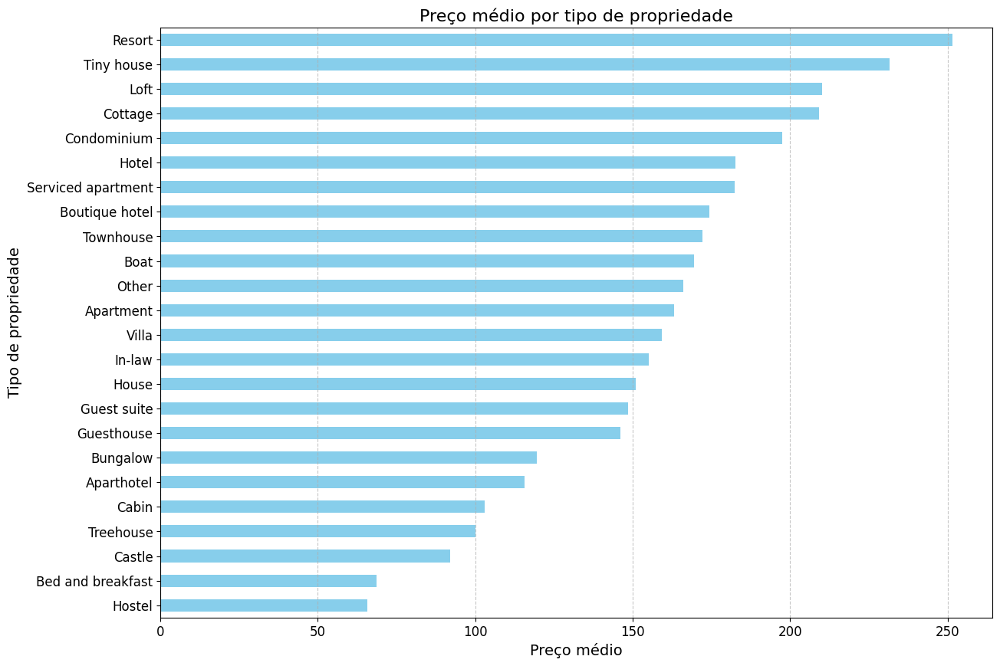

In [41]:
avg_price_per_property_type = df_clean.groupby('property_type')['price'].mean().sort_values()

plt.figure(figsize=(14, 10))
avg_price_per_property_type.plot(kind='barh', color='skyblue')

plt.title('Preço médio por tipo de propriedade', fontsize=16)
plt.xlabel('Preço médio', fontsize=14)
plt.ylabel('Tipo de propriedade', fontsize=14)

plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

plt.grid(axis='x', linestyle='--', alpha=0.7)
plt.show()

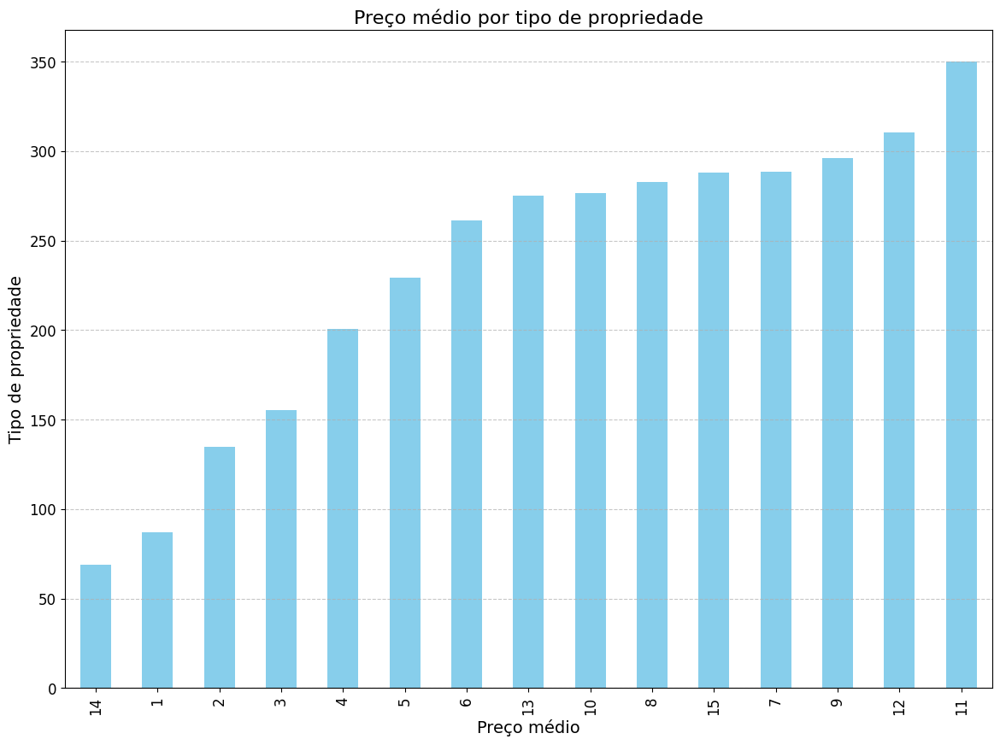

In [42]:
avg_price_per_guests = df_clean.groupby('accommodates')['price'].mean().sort_values()

plt.figure(figsize=(14, 10))
avg_price_per_guests.plot(kind='bar', color='skyblue')

plt.title('Preço médio por tipo de propriedade', fontsize=16)
plt.xlabel('Preço médio', fontsize=14)
plt.ylabel('Tipo de propriedade', fontsize=14)

plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()

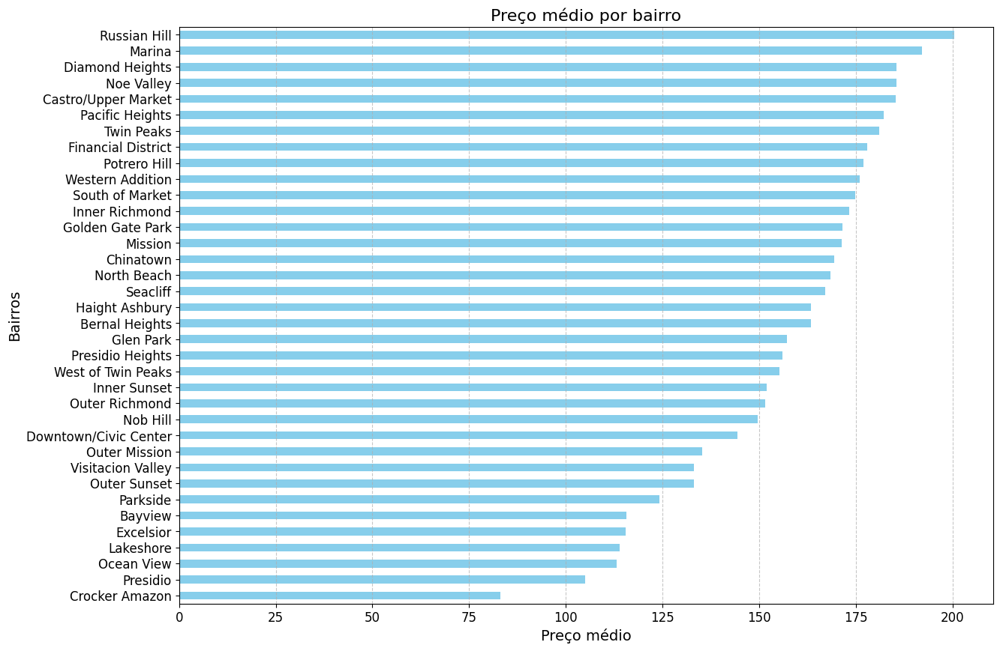

In [43]:
avg_price_per_guests = df_clean.groupby('neighbourhood_cleansed')['price'].mean().sort_values()

plt.figure(figsize=(14, 10))
avg_price_per_guests.plot(kind='barh', color='skyblue')

plt.title('Preço médio por bairro', fontsize=16)
plt.xlabel('Preço médio', fontsize=14)
plt.ylabel('Bairros', fontsize=14)

plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

plt.grid(axis='x', linestyle='--', alpha=0.7)

plt.show()

### **Relação entre Preço e Avaliações gerais de hóspedes**

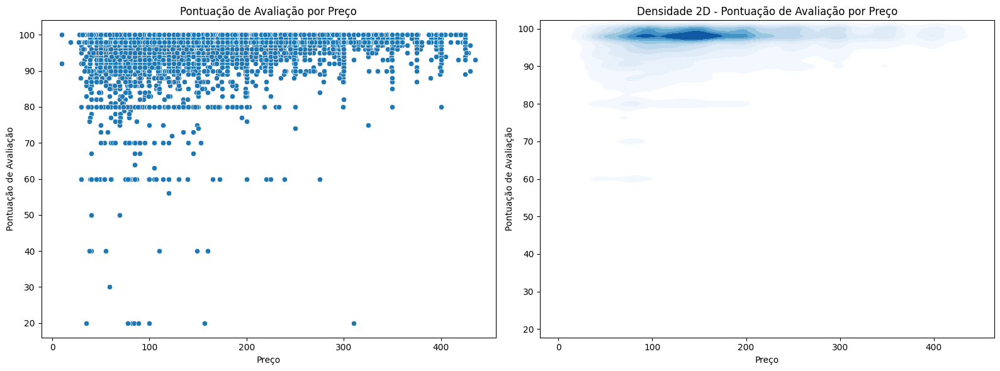

In [44]:
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

sns.scatterplot(x='price', y='review_scores_rating', data=df_clean, ax=axes[0])
axes[0].set_title('Pontuação de Avaliação por Preço')
axes[0].set_xlabel('Preço')
axes[0].set_ylabel('Pontuação de Avaliação')

sns.kdeplot(x=df_clean['price'], y=df_clean['review_scores_rating'], cmap="Blues", fill=True, 
            bw_adjust=0.5, ax=axes[1])
axes[1].set_title('Densidade 2D - Pontuação de Avaliação por Preço')
axes[1].set_xlabel('Preço')
axes[1].set_ylabel('Pontuação de Avaliação')

plt.tight_layout()
plt.show()

- Gráfico de Dispersão (à esquerda): Mostra a relação entre o preço de aluguel dos imóveis do Airbnb e as suas avaliações. Os pontos sobrepostos indicam que há uma concentração de imóveis em certas faixas de preço com avaliações similares. Aparentemente, há uma grande quantidade de imóveis com preços variados que recebem avaliações altas, sugerindo que o preço não é o único determinante para uma avaliação positiva.

- Gráfico de Densidade 2D (à direita): Reforça visualmente onde os dados estão mais agrupados. As áreas mais escuras representam uma maior densidade de imóveis, ou seja, onde mais imóveis compartilham faixas de preço e pontuação de avaliação semelhantes. Este gráfico sugere que a maioria dos imóveis concentra-se em uma faixa de preço mais baixa a média com avaliações razoavelmente altas.

Em resumo, ambos os gráficos indicam que, para os imóveis do Airbnb em São Francisco, há uma variedade de opções de preços com avaliações altas, e que um preço mais elevado não necessariamente garante uma avaliação superior.

### **Relação entre Preço e Avaliações específicas de hóspedes**
Os gráficos fornecidos representam a relação entre o preço dos aluguéis de imóveis no Airbnb e as avaliações específicas dos hóspedes em várias categorias, como precisão, limpeza, check-in, comunicação, localização e valor.

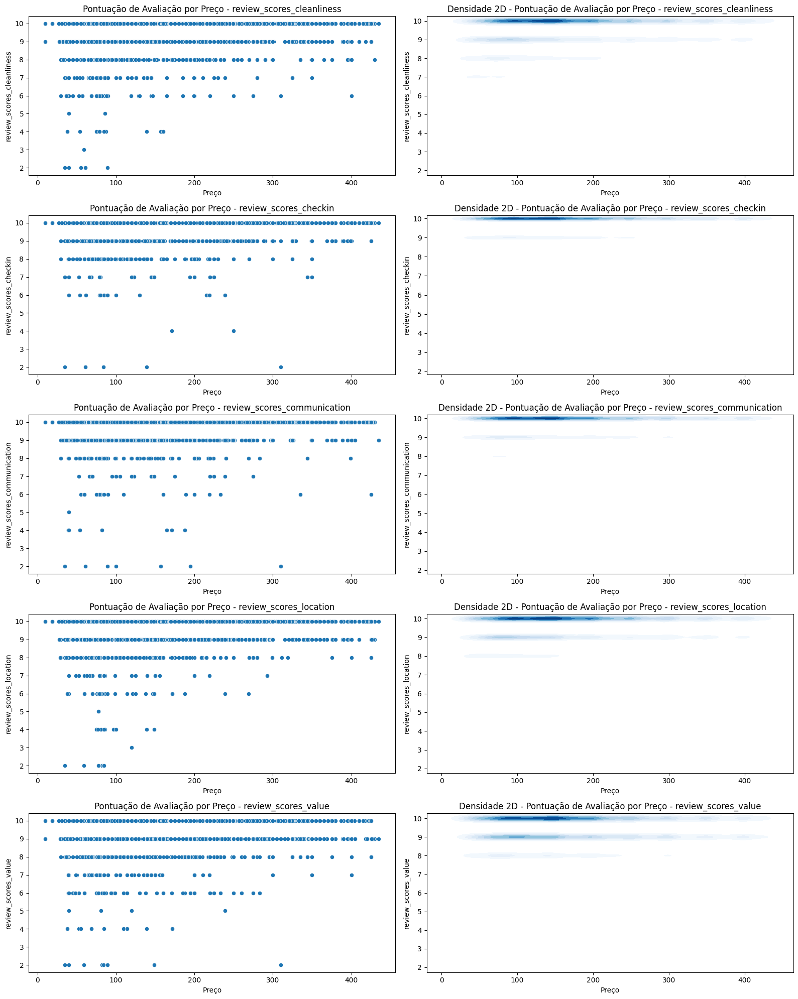

In [45]:
import matplotlib.pyplot as plt
import seaborn as sns

n_variaveis = 5
fig, axes = plt.subplots(n_variaveis, 2, figsize=(16, 4 * n_variaveis))

variaveis = ['review_scores_cleanliness', 'review_scores_checkin',
             'review_scores_communication', 'review_scores_location', 'review_scores_value']

for i, var in enumerate(variaveis):
    sns.scatterplot(x='price', y=var, data=df_clean, ax=axes[i, 0])
    axes[i, 0].set_title(f'Pontuação de Avaliação por Preço - {var}')
    axes[i, 0].set_xlabel('Preço')
    axes[i, 0].set_ylabel(f'{var}')

    sns.kdeplot(x=df_clean['price'], y=df_clean[var], cmap="Blues", fill=True, 
                bw_adjust=0.5, ax=axes[i, 1])
    axes[i, 1].set_title(f'Densidade 2D - Pontuação de Avaliação por Preço - {var}')
    axes[i, 1].set_xlabel('Preço')
    axes[i, 1].set_ylabel(f'{var}')

plt.tight_layout()
plt.show()

- **Limpeza e Preço:**
   - O gráfico de dispersão sugere que imóveis com avaliações de limpeza variam amplamente em preço, mas há uma tendência de pontuações altas em várias faixas de preço, se destacando preços mais baixos.
   - No gráfico de densidade, percebe-se uma concentração de imóveis com avaliações moderadas a altas em limpeza, espalhadas por todas as faixas de preço, mas principalmente nos imóveis de preços mais baixos.

- **Check-in e Preço:**
   - No gráfico de dispersão, a maioria dos imóveis tem avaliações altas de check-in, mas com muita sobreposição nos imóveis de preços baixos e médios.
   - O gráfico de densidade mostra uma alta concentração de imóveis com boa pontuação de check-in em faixas de preço mais baixas a médias.

- **Comunicação e Preço:**
   - O gráfico de dispersão indica que os imóveis são bem avaliados em comunicação em todas as faixas de preço mas, mais uma vez, existe uma sobreposição maior em imóveis de preço mais baixo.
   - O gráfico de densidade confirma que há uma grande quantidade de imóveis com avaliações de comunicação elevadas, particularmente em preços mais acessíveis.

- **Localização e Preço:**
   - O gráfico de dispersão mostra uma distribuição ampla de avaliações de localização em todas as faixas de preço, mas novamente se destacam os preços mais baixos.
   - O gráfico de densidade mostra uma concentração de imóveis com avaliações altas de localização, principalmente em imóveis de preços mais baixos a médios.

- **Valor e Preço:**
   - O gráfico de dispersão mostra que a maioria dos imóveis foi bem avaliado em relação ao valor, mas existe sobreposição nos valores baixos e médios, o que indica que preços mais baixos agradam mais os hóspedes.
   - O gráfico de densidade indica uma concentração de avaliações positivas de valor em preços mais baixos a médios.

A análise geral dos gráficos indica que um preço mais alto para um imóvel no Airbnb em São Francisco não garante necessariamente que o imóvel terá características superiores em termos de limpeza, check-in, comunicação, localização e valor percebido. Há imóveis com avaliações altas em todas essas categorias espalhados por uma ampla gama de preços, mas principalmente em imóveis mais acessíveis. Portanto, escolher pelo preço do imóvel não é uma boa métrica para conseguir um imóvel de qualidade.

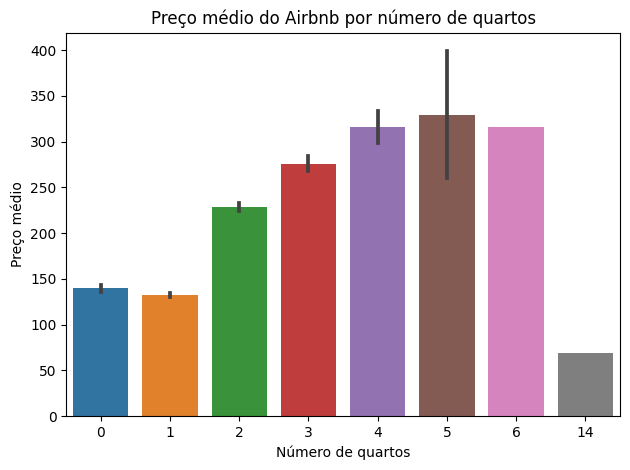

In [46]:
sns.barplot(x='bedrooms', y='price', data=df_clean)
plt.title('Preço médio do Airbnb por número de quartos')
plt.xlabel('Número de quartos')
plt.ylabel('Preço médio')
plt.tight_layout()
plt.show()

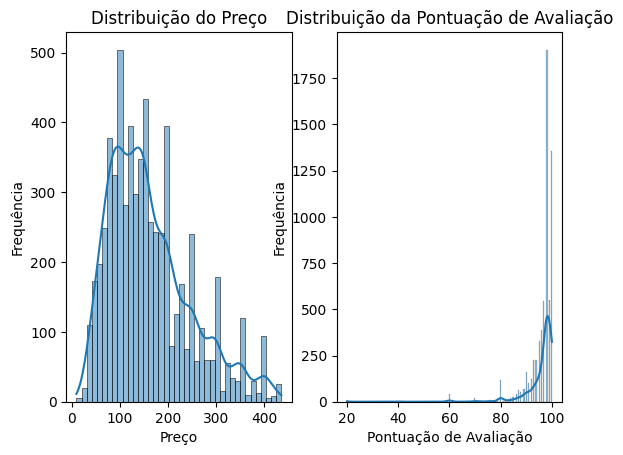

In [47]:
fig, axes = plt.subplots(1, 2)

sns.histplot(df_clean['price'], ax=axes[0], kde=True)
axes[0].set_title('Distribuição do Preço')
axes[0].set_xlabel('Preço')
axes[0].set_ylabel('Frequência')

sns.histplot(df_clean['review_scores_rating'], ax=axes[1], kde=True)
axes[1].set_title('Distribuição da Pontuação de Avaliação')
axes[1].set_xlabel('Pontuação de Avaliação')
axes[1].set_ylabel('Frequência')

plt.show()

## Modelagem

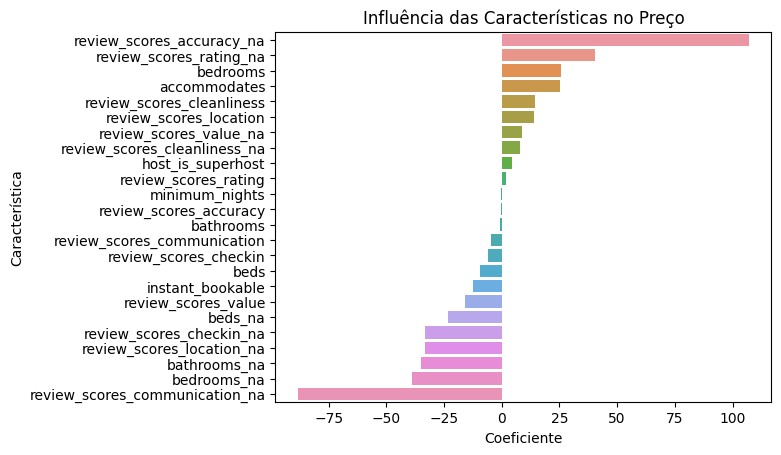

In [48]:
# Variáveis numéricas

df_numeric = df_clean.select_dtypes(include=[np.number])

df_numeric = df_numeric.drop(columns=['Unnamed: 0'], errors='ignore')

df_numeric = df_numeric.drop(columns=['latitude', 'longitude', 'host_total_listings_count', 'number_of_reviews'], errors='ignore')

df_numeric = df_numeric.fillna(df_numeric.mean())

X = df_numeric.drop('price', axis=1)
y = df_numeric['price']

model = LinearRegression()
model.fit(X, y)

coefficients = model.coef_

feature_importance = pd.DataFrame({
    'Feature': X.columns,
    'Coefficient': coefficients
})

feature_importance = feature_importance.sort_values(by='Coefficient', ascending=False)

sns.barplot(x='Coefficient', y='Feature', data=feature_importance)
plt.title('Influência das Características no Preço')
plt.xlabel('Coeficiente')
plt.ylabel('Característica')
plt.show()

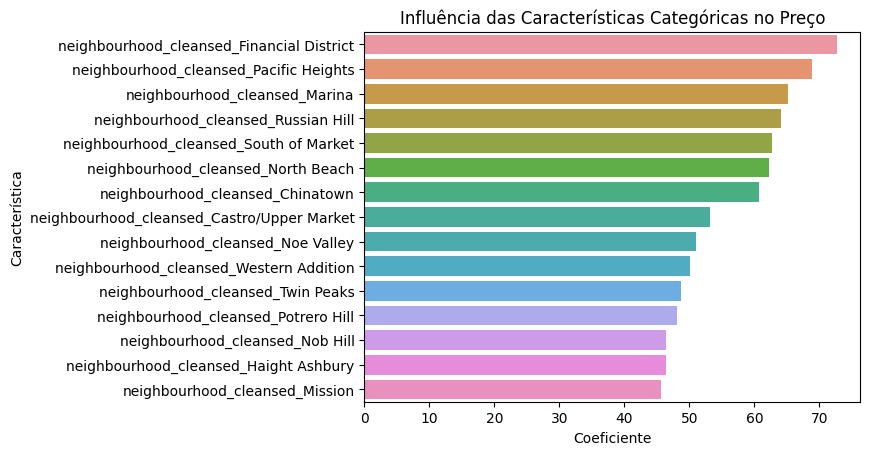

In [49]:
# Variáveis categórias

categorical_columns = df_clean.select_dtypes(include=['object']).columns

onehot_encoder = OneHotEncoder(drop='first', sparse_output=False)
X_categorical = onehot_encoder.fit_transform(df_airbnb[categorical_columns])

X_categorical_df = pd.DataFrame(X_categorical, columns=onehot_encoder.get_feature_names_out(categorical_columns), index=df_airbnb.index)

# Concatenate ensuring aligned indices
X_combined = pd.concat([X, X_categorical_df], axis=1, join='inner')

model = LinearRegression()
model.fit(X_combined, y)

coefficients_categorical = model.coef_[-X_categorical_df.shape[1]:]

feature_importance_categorical = pd.DataFrame({
    'Feature': X_categorical_df.columns,
    'Coefficient': coefficients_categorical
})

feature_importance_categorical = feature_importance_categorical.sort_values(by='Coefficient', ascending=False)

sns.barplot(x='Coefficient', y='Feature', data=feature_importance_categorical.head(15))
plt.title('Influência das Características Categóricas no Preço')
plt.xlabel('Coeficiente')
plt.ylabel('Característica')
plt.show()

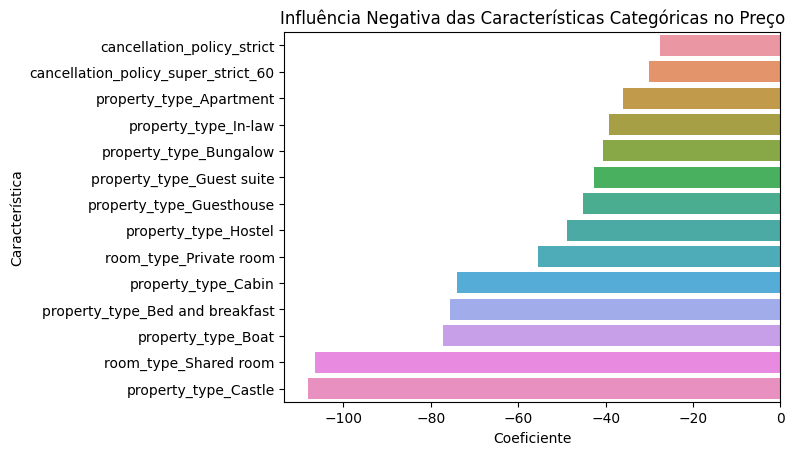

In [50]:
# Variáveis categórias que influenciam negativamente o preço
sns.barplot(x='Coefficient', y='Feature', data=feature_importance_categorical.tail(14))
plt.title('Influência Negativa das Características Categóricas no Preço')
plt.xlabel('Coeficiente')
plt.ylabel('Característica')
plt.show()